## Mantener envolvente espectral

In [118]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import io, signal
from scipy.linalg import solve_toeplitz
from scipy.io.wavfile import read
from IPython.display import Audio
from  matplotlib import patches
from matplotlib.pyplot import axvline, axhline
from scipy.linalg import toeplitz
from scipy.linalg import solve

dir_files = './data/'

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import IPython.display as ipd
from synctoolbox.dtw.mrmsdtw import sync_via_mrmsdtw
from synctoolbox.dtw.utils import compute_optimal_chroma_shift, shift_chroma_vectors, make_path_strictly_monotonic, evaluate_synchronized_positions
from synctoolbox.feature.chroma import pitch_to_chroma, quantize_chroma, quantized_chroma_to_CENS
from synctoolbox.feature.dlnco import pitch_onset_features_to_DLNCO
from synctoolbox.feature.pitch import audio_to_pitch_features
from synctoolbox.feature.pitch_onset import audio_to_pitch_onset_features
from synctoolbox.feature.utils import estimate_tuning

In [119]:
def cargar_audio(directorio, nombre, mono=False):
    # Cargar audio
    sr, data = io.wavfile.read(directorio+nombre)

    if mono:
        # Pasar de estéreo a mono
        if len(data.shape) > 1:
            data = (data[:,0].astype(float) + data[:,1].astype(float))/2

    # normalize maximum (absolute) amplitude
    data = data / np.max(abs(data)) * 0.9

    return sr, data

In [66]:
## 1. Obtencion de las formantes
def lpc_analysis(s, p):
    """ compute the LPC analysis using the autocorrelation method

    Parameters
    ----------
    x : numpy array
        windowed signal frame as a numpy 1D array.
    p : int
        model order.

    Returns
    -------
    ak : numpy array
         model coefficients.
    e : float
        minimum mean squared error.
    e_norm : float
             normalized minimum mean squared error.
    """
    # frame length
    N = s.shape[0]

    # compute autocorrelation values
    r = np.zeros((p+1, 1))
    for k in range(p+1):
        r[k] = np.dot(s[:N-k].T, s[k:N])

    # solve to compute model coefficients
    ak = solve(toeplitz(r[0:p]), r[1:p+1]).squeeze()
    
    # compute mean squared error
    e = r[0] - np.dot(ak.T, r[ 1:p+1])


    # compute normalized mean squared error
    e_norm = e / r[0]

    return ak, e, e_norm

In [189]:
import librosa

In [206]:
def get_envolvente(audio,sr):

    # number of samples in window
    N = 550

    # initial sample of the audio frame
    ind_ini = (len(audio) -N)//2

    # signal frame
    s = audio[ind_ini:ind_ini+N]

    # smoothing window
    window = signal.windows.get_window('hann', N)

    # windowed signal frame
    s_win  = s  * window

    # number of DFT points
    Ndft = 4056

    # spectrum of the signal frame
    X  = np.fft.fft(s_win, Ndft)
    # frequency values
    f  = np.fft.fftfreq(Ndft) * sr

    # model order
    p = sr//1000

    # apply lpc analysis to signal frame
    ak , e , e_norm = lpc_analysis(s_win , p)
    # ak = librosa.lpc(s_win,order=p)

    # filter obtained from the lpc analysis
    S = 1
    U  = np.concatenate([[1], -ak ])

    # compute gain
    G  = np.sqrt(e)

    # compute the frequency response of the digital filter
    w , H  = signal.freqz(G *S, U , worN=Ndft, whole=True)
    fw  = w  / (2 * np.pi) * sr

    ########################3
    # inverse filter
    A = S*G
    B = U

    # compute the excitation from the inverse filter
    p = signal.lfilter(B, A, s_win)

    # compute the spectrum of the excitation
    P = np.fft.fft(p, Ndft)
    magP = np.abs(P)
    ind_fmx = int(Ndft/2)

    return H, X,f, magP

In [207]:
fs, data = cargar_audio(dir_files, 'Emily_Linge-vocals.wav', mono=True)

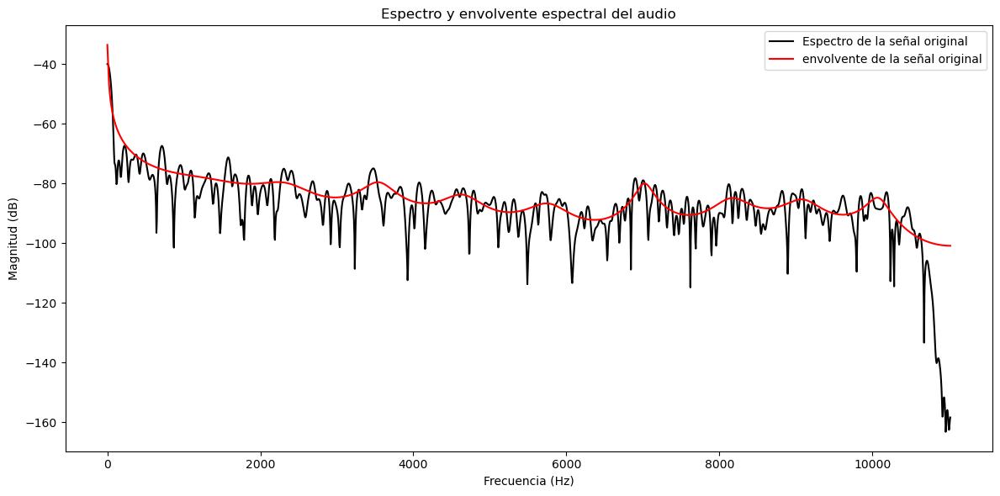

In [208]:
Ndft = 4056

H, X,f,magP = get_envolvente(data,fs)

# magnitude spectrum
magH = np.abs(H)
ind_fmx = int(Ndft/2)
# magnitude spectrum
magX = np.abs(X)
ind_fmx = int(Ndft/2)

# plot the frequency response
plt.figure(figsize=(12,6))
ax1 = plt.subplot()
ax1.set_title('Espectro y envolvente espectral del audio')
ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original")
ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente de la señal original")
ax1.set_ylabel('Magnitud (dB)')
ax1.set_xlabel('Frecuencia (Hz)')
plt.legend()
plt.tight_layout()


Emily pitch shifted

In [223]:
fs_ps, emily_pitch_shift = cargar_audio(dir_files, 'Emily_pitch_shift.wav', mono=True)

H_emily_shft, X_emily_shft,f_emily_shft, magP_emily_shifted = get_envolvente(emily_pitch_shift,fs_ps)

Audio(emily_pitch_shift, rate=fs)

C:\Users\victo\AppData\Local\Temp\ipykernel_21328\3344462408.py:12: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magX_emily_shft[:ind_fmx_emily_shft]), 'k',label="Espectro de la señal emily shifted",color='black')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\3344462408.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r" (-> color=(1.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magH_emily_shft[:ind_fmx_emily_shft]), 'r',label="Envolvente de emily shifted",color='red')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\3344462408.py:14: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword a

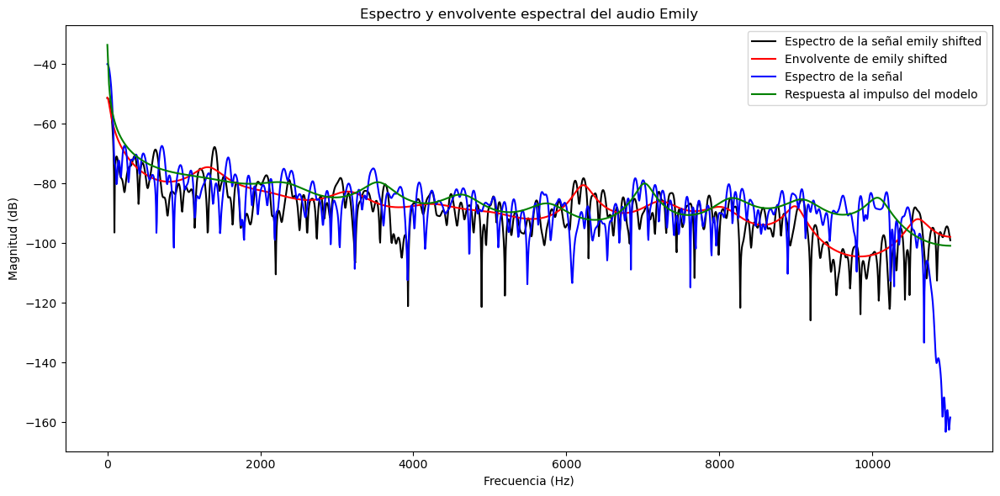

In [224]:
# magnitude spectrum
magH_emily_shft = np.abs(H_emily_shft)
ind_fmx_emily_shft = int(Ndft/2)
# magnitude spectrum
magX_emily_shft = np.abs(X_emily_shft )
ind_fmx_emily_shft = int(Ndft/2)

# plot the frequency response
plt.figure(figsize=(12,6))
ax1 = plt.subplot()
ax1.set_title('Espectro y envolvente espectral del audio Emily')
ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magX_emily_shft[:ind_fmx_emily_shft]), 'k',label="Espectro de la señal emily shifted",color='black')
ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magH_emily_shft[:ind_fmx_emily_shft]), 'r',label="Envolvente de emily shifted",color='red')
ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal",color='blue')
ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="Respuesta al impulso del modelo",color='green')
ax1.set_ylabel('Magnitud (dB)')
ax1.set_xlabel('Frecuencia (Hz)')
plt.legend()
plt.tight_layout()


### Corregir la envolvente del audio shifteado usando la envolvente del audio original

In [373]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt

## Cargar el archivo de audio
audio_path = "Emily_Linge-vocals.wav"  # Reemplaza con tu archivo
sr, y = cargar_audio(dir_files, audio_path, mono=True)

# # STFT: Espectrograma complejo
n_fft = 2048
hop_length = 550
S = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)
magnitude, phase = np.abs(S), np.angle(S)

################
#partir el audio en tramos de ancho de ventana stft
#hacerle lpc a cada tramo
#hacer correccion de la envolvente a cada tramo
###############

# # Calcular la envolvente espectral del audio original
# # Promedio de las magnitudes por bandas de frecuencia
# envelope = np.mean(magnitude, axis=1)
envelope = magnitude.copy()
for i in range(magnitude.shape[0]):
    envelope[:,i] = np.convolve(magnitude[:,i], np.ones(50)/50, mode='same')

# Modificar la altura (pitch shifting)
n_steps = 2  # Cambia la altura en semitonos
y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=n_steps)

# # Modified audio path
# audio_path = "Emily_pitch_shift.wav"  # Reemplaza con tu archivo
# sr, y_shifted = cargar_audio(dir_files, audio_path, mono=True)

# STFT del audio modificado
S_shifted = librosa.stft(y_shifted, n_fft=n_fft, hop_length=hop_length)
magnitude_shifted, phase_shifted = np.abs(S_shifted), np.angle(S_shifted)
print("magnitude_shifted",magnitude_shifted.shape)


envelope_shifted = magnitude_shifted.copy()
for i in range(magnitude_shifted.shape[1]):
    envelope_shifted[:,i] = np.convolve(magnitude_shifted[:,i], np.ones(50)/50, mode='same')
##################################################################################


# Reconstruir la envolvente espectral en el audio modificado
# Normalizamos la envolvente original y la aplicamos a las magnitudes desplazadas
# magnitude_reconstructed = (envelope[:, np.newaxis] / np.max(envelope)) * np.mean(magnitude_shifted, axis=0)
magnitude_reconstructed = magnitude_shifted / (envelope_shifted + 1e-10) *(envelope)
# magnitude_reconstructed = (magnitude_shifted / np.mean(magnitude_shifted, axis=1)[:, np.newaxis]) * envelope[:, np.newaxis] 

# Reconstruir el espectrograma complejo
S_reconstructed = magnitude_reconstructed * np.exp(1j * phase_shifted)

# Inversa de STFT: Reconstrucción del audio
y_reconstructed = librosa.istft(S, hop_length=hop_length)

import scipy.io.wavfile
scipy.io.wavfile.write("audio_reconstructed.wav", sr, y_reconstructed)


magnitude_shifted (1025, 10173)


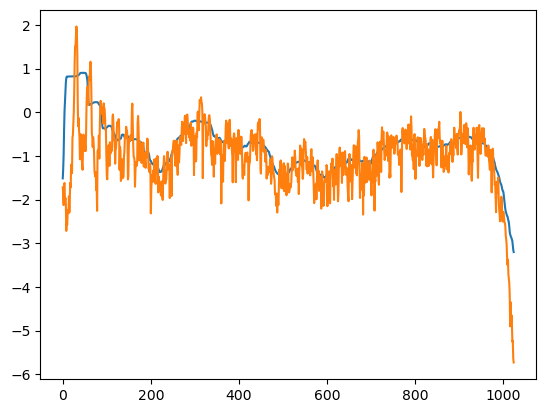

[0.03047613 0.05081583 0.10893271 ... 0.00088844 0.00071089 0.00062753]


In [291]:
plt.figure()
plt.plot(np.log10(envelope_shifted[:,3000]))
plt.plot(np.log10(magnitude_shifted[:,3000]))
plt.show()
print(envelope_shifted[:,3000])

In [375]:
fs, data_reconstruida = cargar_audio(dir_files, "audio_reconstructed.wav", mono=True)

# H_reconstruida, X_reconstruida, f_reconstruida, magP_reconstruida = get_envolvente(data_reconstruida,fs)

Audio(data_reconstruida, rate=fs)

C:\Users\victo\AppData\Local\Temp\ipykernel_21328\2535625741.py:12: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original",color='orange')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\2535625741.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r" (-> color=(1.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente original",color='purple')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\2535625741.py:16: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(mag

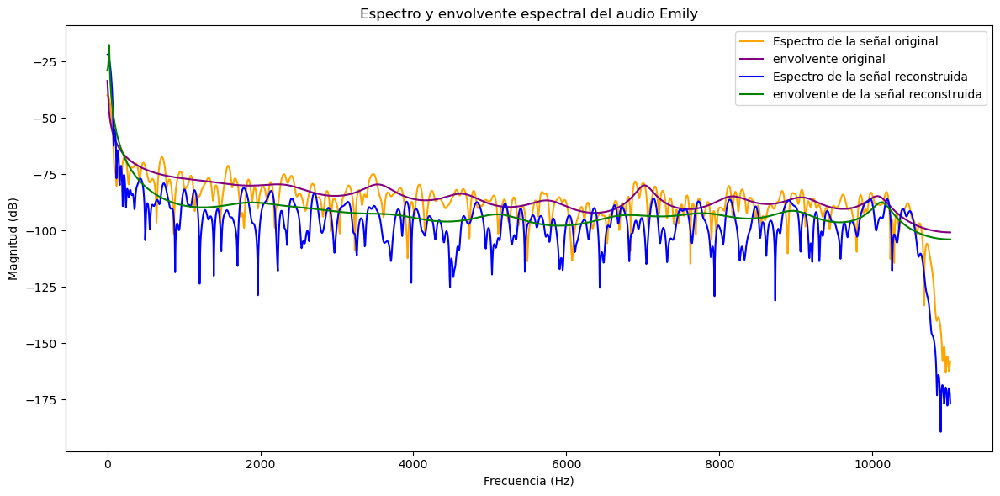

In [293]:
# magnitude spectrum
magH_reconstruida = np.abs(H_reconstruida)
ind_fmx_reconstruida = int(Ndft/2)
# magnitude spectrum
magX_reconstruida = np.abs(X_reconstruida )
ind_fmx_reconstruida = int(Ndft/2)

# plot the frequency response
plt.figure(figsize=(12,6))
ax1 = plt.subplot()
ax1.set_title('Espectro y envolvente espectral del audio Emily')
ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original",color='orange')
ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente original",color='purple')
# ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magX_emily_shft[:ind_fmx_emily_shft]), 'k',label="Espectro de la señal emily shifted",color='black')
# ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magH_emily_shft[:ind_fmx_emily_shft]), 'r',label="envolvente emily shifted",color='red')
ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(magX_reconstruida[:ind_fmx_reconstruida]), 'k',label="Espectro de la señal reconstruida",color='blue')
ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(magH_reconstruida[:ind_fmx_reconstruida]), 'r',label="envolvente de la señal reconstruida",color='green')
ax1.set_ylabel('Magnitud (dB)')
ax1.set_xlabel('Frecuencia (Hz)')
plt.legend()
plt.tight_layout()


#### Check de la altura del audio corregido

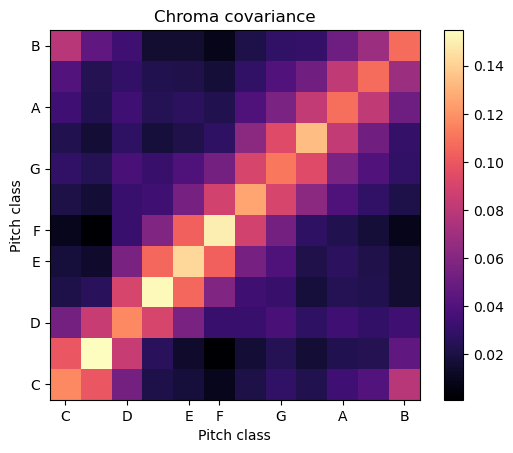

In [289]:
fs_ps, Police = cargar_audio(dir_files, 'Police-vocals-guitar.wav', mono=True)

chroma = librosa.feature.chroma_stft(y=data_reconstruida)

ccov = np.cov(chroma)
fig, ax = plt.subplots()
img = librosa.display.specshow(ccov, y_axis='chroma', x_axis='chroma', ax=ax)
ax.set(title='Chroma covariance')
fig.colorbar(img, ax=ax)

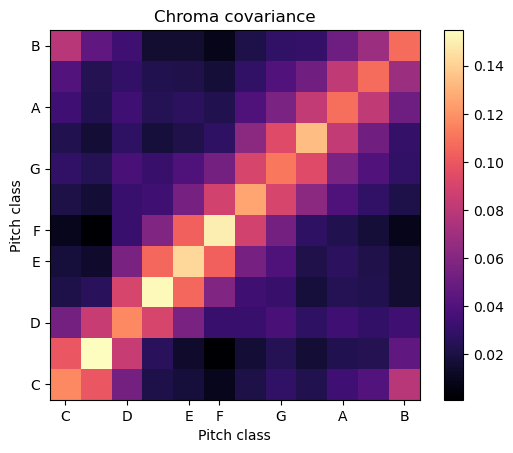

In [287]:
## correlation mattrix

chroma = librosa.feature.chroma_stft(y=data_reconstruida)

ccov = np.cov(chroma)
fig, ax = plt.subplots()
img = librosa.display.specshow(ccov, y_axis='chroma', x_axis='chroma', ax=ax)
ax.set(title='Chroma covariance')
fig.colorbar(img, ax=ax)

### Segunda prueba: lpc en tiempo corto 

In [389]:
## Cargar el archivo de audio original 
audio_path = "Emily_Linge-vocals.wav"  # Reemplaza con tu archivo
sr, y = cargar_audio(dir_files, audio_path, mono=True)

# # STFT: Espectrograma complejo
n_fft = 2048
hop_length = 512
S = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)
magnitude, phase = np.abs(S), np.angle(S)

####
## Cargar el archivo de audio original 
audio_path = "Emily_pitch_shift.wav"  # Reemplaza con tu archivo
sr, y_pitch_shift = cargar_audio(dir_files, audio_path, mono=True)

# # STFT: Espectrograma complejo
n_fft = 2048
hop_length = 512
S = librosa.stft(y_pitch_shift, n_fft=n_fft, hop_length=hop_length)
magnitude_pitch_shift, phase_shifted = np.abs(S), np.angle(S)

In [395]:
S_reconstructed = magnitude_pitch_shift * np.exp(1j * phase_shifted)

# Inversa de STFT: Reconstrucción del audio
y_reconstructed = librosa.istft(S_reconstructed, hop_length=hop_length)


Audio(y_reconstructed, rate=fs)

In [408]:
from scipy.linalg import toeplitz, solve
import numpy as np

def get_lpc(s, p=20):
    """Compute the LPC analysis using the autocorrelation method."""
    N = s.shape[0]
    p = min(p, N - 1)  # Asegurar que p no sea mayor que el tamaño del marco

    # Compute autocorrelation values
    r = np.zeros((p + 1,))
    for k in range(p + 1):
        r[k] = np.dot(s[:N - k], s[k:])

    if np.all(r == 0):
        raise ValueError("Autocorrelation is zero; the input signal may be silent or constant.")

    # Solve to compute model coefficients
    try:
        ak = solve(toeplitz(r[:p]) + 1e-6 * np.eye(p), r[1:p + 1]).squeeze()
    except np.linalg.LinAlgError:
        raise ValueError("Matrix is singular. Adjust the model order or check input data.")

    # Compute mean squared error
    e = r[0] - np.dot(ak.T, r[1:p + 1])

    # Compute normalized mean squared error
    e_norm = e / r[0] if r[0] != 0 else 0

    return ak, e, e_norm
from typing import Any


from numpy import dtype
from numpy._typing._array_like import NDArray


def lpc_analysis(sig, sr, frame=512, getPlot=False, p=0, retType='dB', Ndft=1024):
    n = frame
    window = signal.windows.get_window('hann', n)  # Smoothing window
    lpc_matrix = []
    threshold = 1e-12  # Umbral para detectar silencio
    
    i = 0
    for j in range(0,len(sig),frame):
        chunk = sig[j:j+Ndft]
        i += 1
        if len(chunk) < n:
            chunk = np.pad(chunk, (0, n - len(chunk)), mode='constant')  # Padding
        
        window = signal.windows.get_window('hann', len(chunk))  # Ajustar ventana
        s_win = chunk * window  # Señal con ventana
        
        # Detectar silencio
        if np.max(np.abs(s_win)) < threshold:
            # print(f"Skipping silent segment {i}")
            lpc_matrix.append(np.zeros(Ndft // 2))
            continue
        
        # Normalizar segmento
        s_win = s_win / (np.max(np.abs(s_win)) + 1e-12)
        
        try:
            ak, e, e_norm = get_lpc(s_win, p if p else int(sr / 1000))
        except ValueError as ve:
            print(f"Error processing segment: {ve}")
            continue
        
        
        # Espectro de magnitud
        X = np.fft.fft(s_win, Ndft)
        magX = np.abs(X[:Ndft // 2])
        
        # filter obtained from the lpc analysis
        S = 1
        U = np.concatenate([[1], -ak])
        G = np.sqrt(e) # compute gain
        w, H = signal.freqz(G*S, U, worN=Ndft, whole=True) # compute the frequency response of the digital filter
        magH = np.abs(H[:Ndft // 2])
        
        lpc_matrix.append(20 * np.log10(magH) if retType == 'dB' else magH)
        
        if getPlot:
            plt.plot(20 * np.log10(magX))
            plt.title("Magnitude Spectrum")
            plt.show()

    
    return np.array(lpc_matrix), magH


In [409]:
envolventes_original, magH_original = lpc_analysis(y, sr, hop_length)
envolventes_shifted, magH_shifted = lpc_analysis(y_pitch_shift, sr, hop_length)

In [410]:
print(envolventes_original.shape)
print(envolventes_shifted.shape)

(10928, 512)
(10928, 512)


In [411]:
magnitude_shifted = magnitude_pitch_shift.T

print(magnitude_shifted.shape)

(10928, 1025)


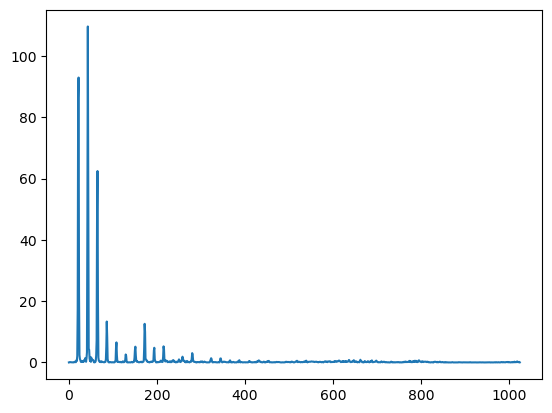

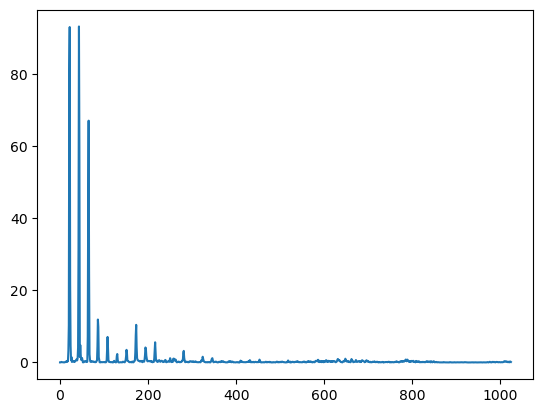

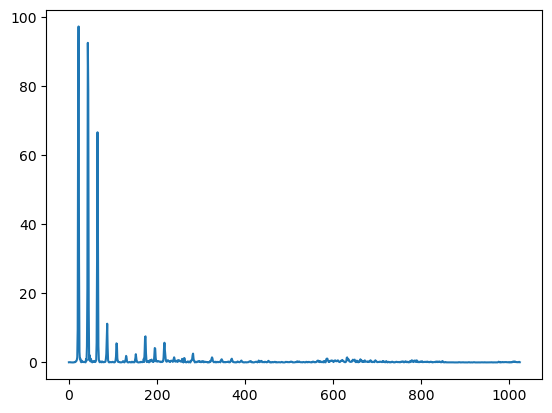

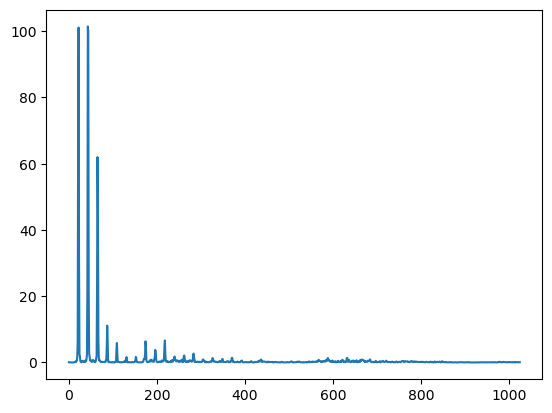

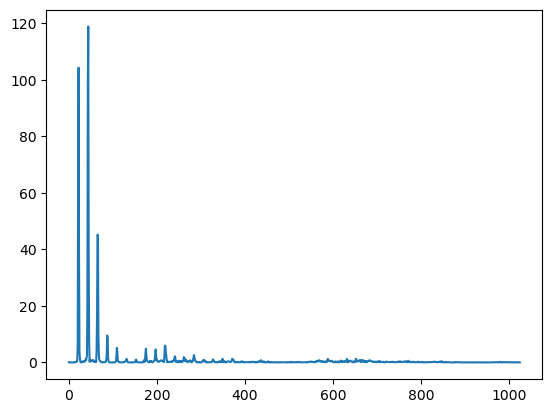

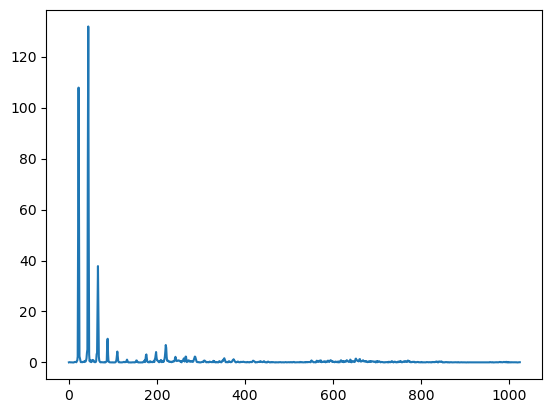

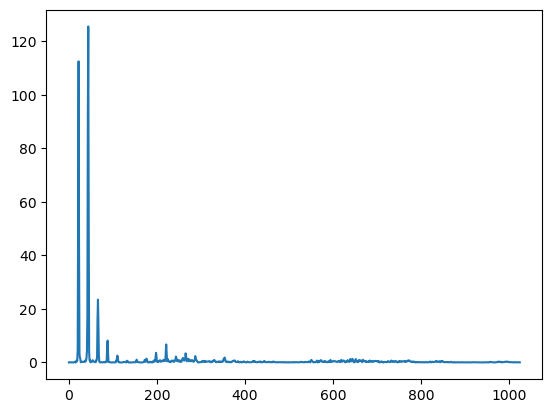

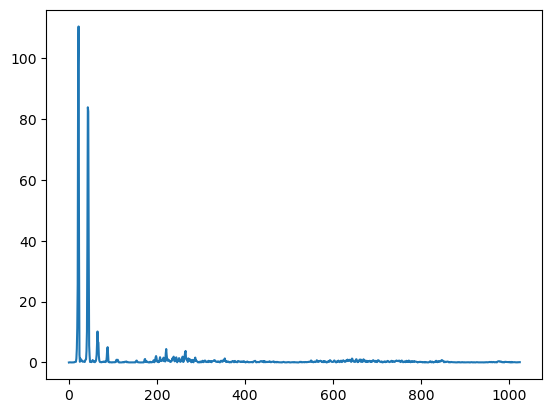

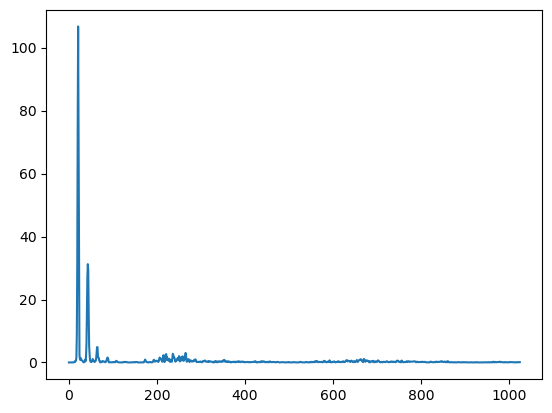

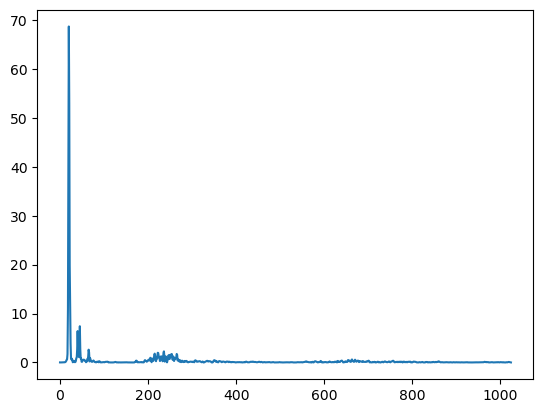

In [413]:
for sig in magnitude_shifted[2000:2010]:
    plt.plot(sig)
    plt.show()

In [414]:
magnitude_reconstructed = magnitude_shifted / (envolventes_shifted + 1e-10) * (envolventes_original)
phase_shifted_ = phase_shifted.T[:,phase_shifted.shape[0]//2+1:]

S_reconstructed = magnitude_reconstructed * np.exp(1j * phase_shifted_)

# Inversa de STFT: Reconstrucción del audio
y_reconstructed = librosa.istft(S_reconstructed, hop_length=hop_length)


Audio(y_reconstructed, rate=fs)

ValueError: operands could not be broadcast together with shapes (10928,1025) (10928,512) 

C:\Users\victo\AppData\Local\Temp\ipykernel_21328\997936226.py:12: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original",color='orange')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\997936226.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r" (-> color=(1.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente original",color='purple')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\997936226.py:16: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(magX_r

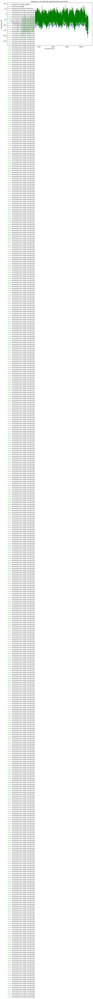

In [327]:
# magnitude spectrum
magH_reconstruida = np.abs(magnitude_reconstructed)
ind_fmx_reconstruida = int(Ndft/2)
# magnitude spectrum
magX_reconstruida = np.abs(X_reconstruida )
ind_fmx_reconstruida = int(Ndft/2)

# plot the frequency response
plt.figure(figsize=(12,6))
ax1 = plt.subplot()
ax1.set_title('Espectro y envolvente espectral del audio Emily')
ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original",color='orange')
ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente original",color='purple')
# ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magX_emily_shft[:ind_fmx_emily_shft]), 'k',label="Espectro de la señal emily shifted",color='black')
# ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magH_emily_shft[:ind_fmx_emily_shft]), 'r',label="envolvente emily shifted",color='red')
ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(magX_reconstruida[:ind_fmx_reconstruida]), 'k',label="Espectro de la señal reconstruida",color='blue')
ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(magH_reconstruida[:ind_fmx_reconstruida]), 'r',label="envolvente de la señal reconstruida",color='green')
ax1.set_ylabel('Magnitud (dB)')
ax1.set_xlabel('Frecuencia (Hz)')
plt.legend()
plt.tight_layout()

In [ ]:




################
#partir el audio en tramos de ancho de ventana stft
#hacerle lpc a cada tramo
#hacer correccion de la envolvente a cada tramo
###############

# # Calcular la envolvente espectral del audio original
# # Promedio de las magnitudes por bandas de frecuencia
# envelope = np.mean(magnitude, axis=1)
envelope = magnitude.copy()
for i in range(magnitude.shape[0]):
    envelope[:,i] = np.convolve(magnitude[:,i], np.ones(50)/50, mode='same')

# Modificar la altura (pitch shifting)
n_steps = 2  # Cambia la altura en semitonos
y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=n_steps)

# # Modified audio path
# audio_path = "Emily_pitch_shift.wav"  # Reemplaza con tu archivo
# sr, y_shifted = cargar_audio(dir_files, audio_path, mono=True)

# STFT del audio modificado
S_shifted = librosa.stft(y_shifted, n_fft=n_fft, hop_length=hop_length)
magnitude_shifted, phase_shifted = np.abs(S_shifted), np.angle(S_shifted)
print("magnitude_shifted",magnitude_shifted.shape)


envelope_shifted = magnitude_shifted.copy()
for i in range(magnitude_shifted.shape[1]):
    envelope_shifted[:,i] = np.convolve(magnitude_shifted[:,i], np.ones(50)/50, mode='same')
##################################################################################


# Reconstruir la envolvente espectral en el audio modificado
# Normalizamos la envolvente original y la aplicamos a las magnitudes desplazadas
# magnitude_reconstructed = (envelope[:, np.newaxis] / np.max(envelope)) * np.mean(magnitude_shifted, axis=0)
magnitude_reconstructed = magnitude_shifted / (envelope_shifted + 1e-10) *(envelope)
# magnitude_reconstructed = (magnitude_shifted / np.mean(magnitude_shifted, axis=1)[:, np.newaxis]) * envelope[:, np.newaxis] 

# Reconstruir el espectrograma complejo
S_reconstructed = magnitude_reconstructed * np.exp(1j * phase_shifted)

# Inversa de STFT: Reconstrucción del audio
y_reconstructed = librosa.istft(S_reconstructed, hop_length=hop_length)


import scipy.io.wavfile
scipy.io.wavfile.write("audio_reconstructed.wav", sr, y_reconstructed)